In [1]:
import os

base_dir = os.getcwd()

input_dir = os.path.join(base_dir, "data/")

photos_path = os.path.join(input_dir, "monet/photo_jpg")
monet_path = os.path.join(input_dir, "monet/monet_jpg")

# Imports

In [2]:
import random
import re
import shutil
import zipfile
from itertools import chain

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
from PIL import Image
from torch.optim import lr_scheduler
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from torchvision import transforms

from model import config
from model.dataset import SingleDomainImageDataset, get_loaders
from model.discriminator import Discriminator
from model.generator import Generator
from model.image_buffer import ImageBuffer
from model.model import CycleGAN, train

## Setting up

In [3]:
BATCH_SIZE = config.BATCH_SIZE
IMG_SIZE = config.IMAGE_SIZE
DEVICE = config.DEVICE
NUM_WORKERS = config.NUM_WORKERS

## Random seeds

In [4]:
torch.manual_seed(config.RANDOM_SEED)
torch.cuda.manual_seed_all(config.RANDOM_SEED)
np.random.seed(config.RANDOM_SEED)
random.seed(config.RANDOM_SEED)

# Data

Let\`s inspect the data a little bit. In `monet_jpg` directory we have jpg images of Monet\`s paintings. Also we have different real photos in `photo_jpg` directory.

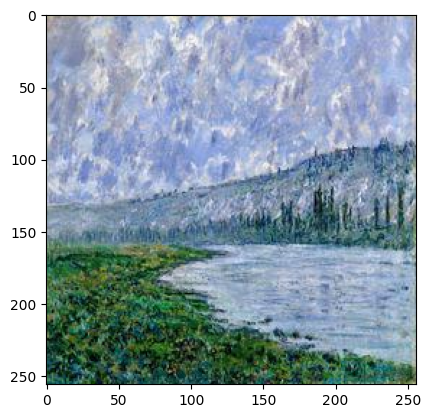

In [5]:
image = Image.open(os.path.join(monet_path, "0bd913dbc7.jpg"))
plt.imshow(image)
plt.show()

Let\`s take a look at our image more closely. We have 256x256x3 arrays (256 pixels in height, 256 pixels in width and 3 channels - RGB). Also we can see, that images have values from 0 to 255 (8-bit images).

In [6]:
image_data = np.asarray(image)
print(f"Shape: {image_data.shape}")
print(f"Data type: {image_data.dtype}")
print(f"Min: {image_data.min()}, Max: {image_data.max()}")

Shape: (256, 256, 3)
Data type: uint8
Min: 0, Max: 255


So let\`s take a look at 25 random images from each domain.

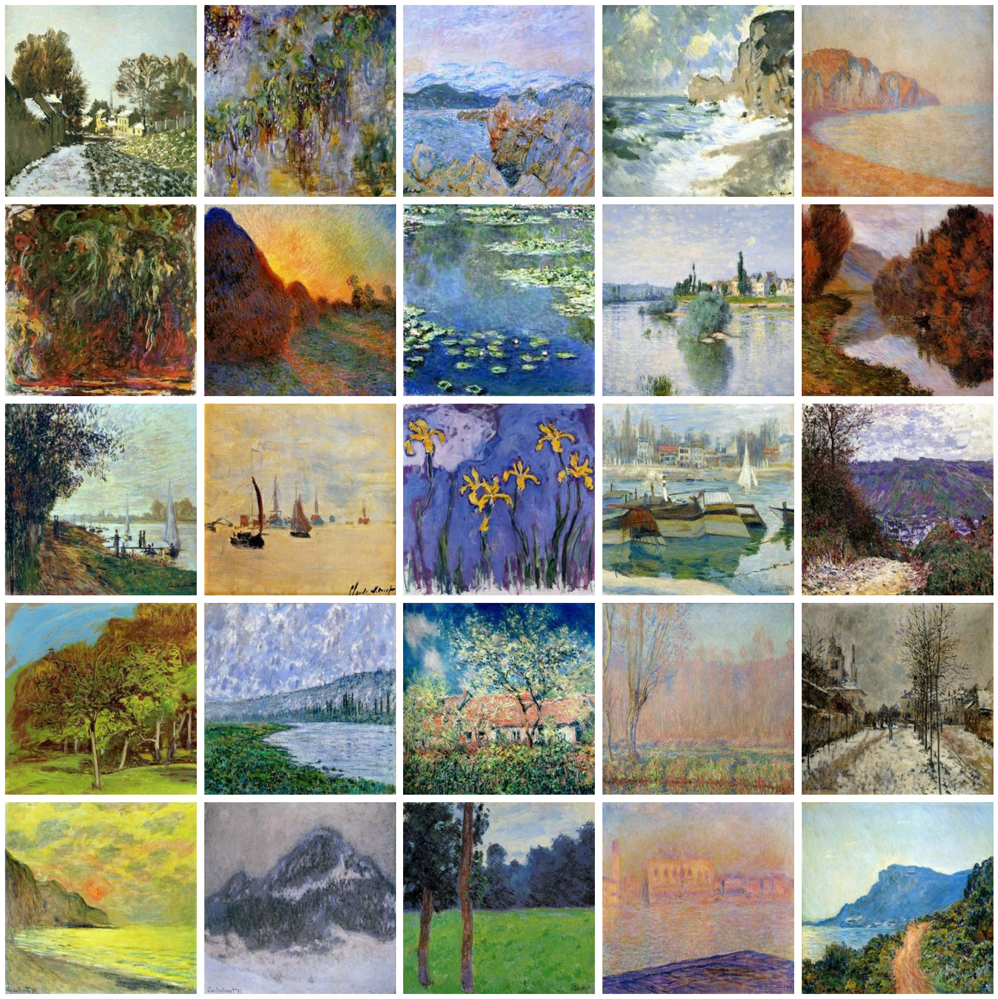

In [7]:
def show_images_from_path(images_directory, num_images=25):
    images = os.listdir(images_directory)
    images = [os.path.join(images_directory, image) for image in images]
    images = random.sample(images, num_images)

    fig, axes = plt.subplots(5, 5, figsize=(20, 20))
    axes = axes.flatten()
    for i, image_path in enumerate(images):
        image = Image.open(image_path)
        axes[i].imshow(image)
        axes[i].axis("off")
    plt.tight_layout()
    plt.show()

show_images_from_path(monet_path)

For sure we can see, that Cloude Monet paintings are more colorful and have more brush strokes, than real photos. Also we can see, that Monet\`s paintings contain a lot of landscapes.

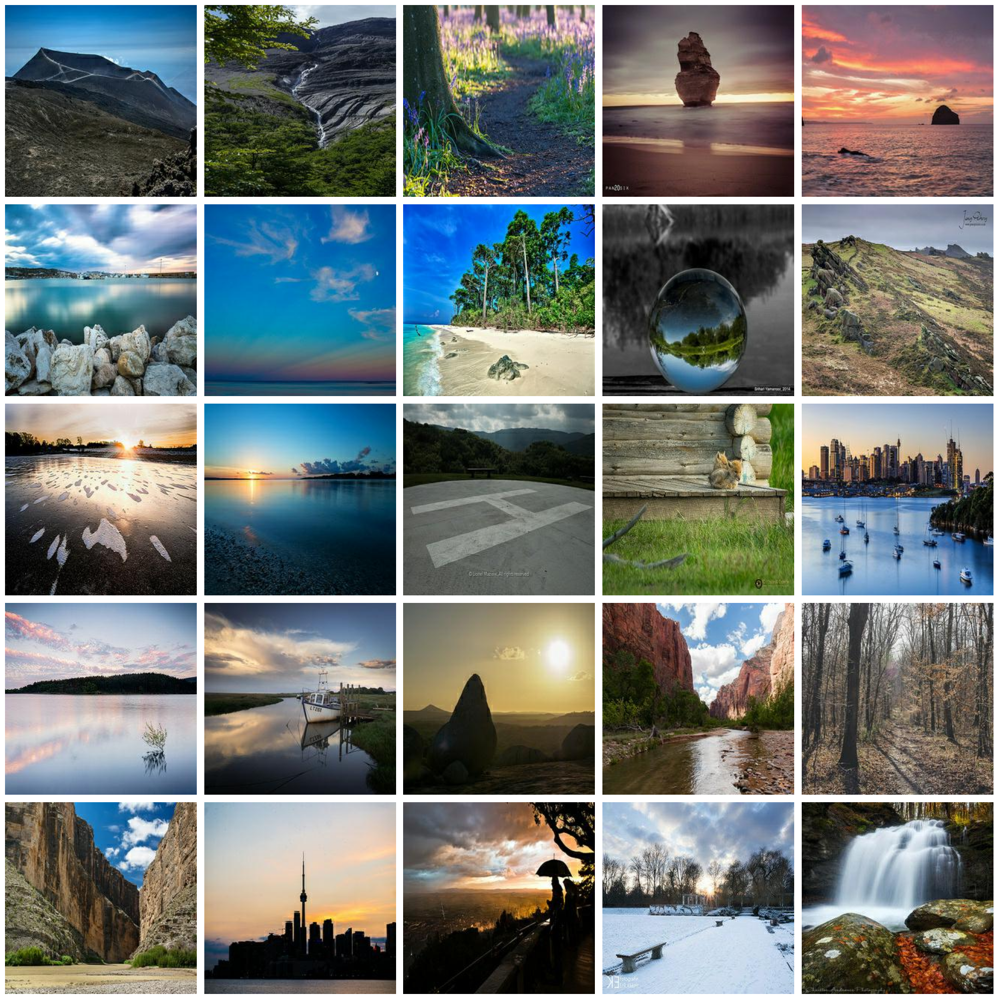

In [8]:
show_images_from_path(photos_path)

As we can see in real photos dataset we also have mostly landscapes, but also we can sometimes observe people, animals, buildings and other objects.

## Transformation pipeline and data augmentation

For augmentation we will only use horizontal flip, because we don't want to distort the images to much. We also normalize our images to have values between -1 and 1. For validation set we will only normalize images.

In [9]:
train_transform = transforms.Compose(
    [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)
val_transform = test_transform = transforms.Compose(
    [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)

Let\`s test our transformation on `image_data`.

In [10]:
transformed_image = train_transform(image)
print(f"Shape: {transformed_image.shape}")
print(f"Data type: {transformed_image.dtype}")
print(f"Min: {transformed_image.min()}, Max: {transformed_image.max()}")

Shape: torch.Size([3, 256, 256])
Data type: torch.float32
Min: -1.0, Max: 1.0


## Creating data loaders

In [11]:
train_loader, val_loader = get_loaders(
    photos_path,
    monet_path,
    train_transform,
    val_transform,
    batch_size=BATCH_SIZE,
    train_split=0.9,
    num_workers=NUM_WORKERS,
)

Let\`s test our loaders and see some images from them.

In [12]:
def show_sample(dataset, num_samples=1):
    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 5 * num_samples))

    if num_samples == 1:
        axes = [axes]

    for i in range(num_samples):
        idx = torch.randint(0, len(dataset), (1,)).item()

        real_image, monet_image = dataset[idx]

        real_image = (real_image + 1) / 2
        monet_image = (monet_image + 1) / 2

        real_image = real_image.permute(1, 2, 0).numpy()
        monet_image = monet_image.permute(1, 2, 0).numpy()

        axes[i][0].imshow(real_image)
        axes[i][0].set_title("Real image")
        axes[i][0].axis("off")

        axes[i][1].imshow(monet_image)
        axes[i][1].set_title("Monet image")
        axes[i][1].axis("off")

    plt.show()

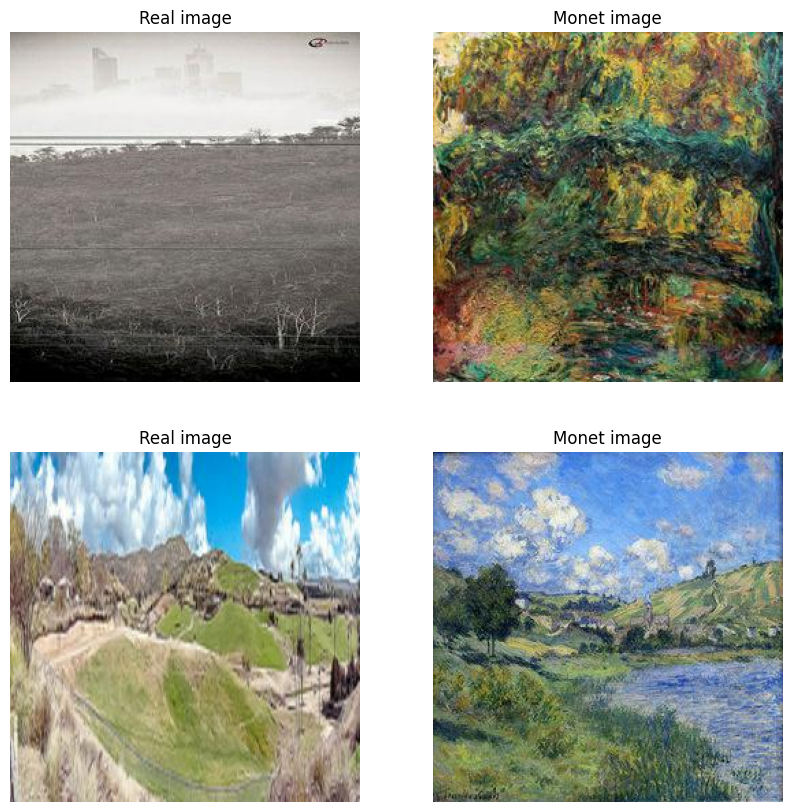

In [38]:
show_sample(train_loader.dataset, num_samples=2)

# Model

## CycleGAN

We will use CycleGAN model to generate monet paintings from photos.
This model consists of two generators and two discriminators.
Idea behind this model is to learn mapping to transform images from one domain to another and vice versa. [Link to paper](https://arxiv.org/pdf/1703.10593).

### Generator

We have generator for our model. The architecture of the generator is the following:
1. Initial convolutional layer with kernel size 7x7 and stride 1.
2. Several convolutional blocks of downsampling layers.
3. Several residual blocks.
4. Several convolutional blocks of upsampling layers.
5. Final convolutional layer with kernel size 7x7 and stride 1.

In [14]:
gen = Generator()
x = torch.randn((1, 3, IMG_SIZE, IMG_SIZE))
gen_out = gen(x)
print(f"gen_out shape: {gen_out.shape}, gen_in shape: {x.shape}")

gen_out shape: torch.Size([1, 3, 256, 256]), gen_in shape: torch.Size([1, 3, 256, 256])


We can see, that output of the generator is the same shape as input, because we want generator to change the style of image. We could look at generated image, but for now it will be just noise.

### Discriminator

For discriminator we will use PatchGAN discriminator. The architecture of the discriminator is the following:
1. Initial convolutional layer with kernel size 4x4 and stride 2.
2. Several convolutional blocks.
3. Final convolutional layer with kernel size 4x4 and stride 2.

In the end we will have 1x15x15 output for each image which will be used to calculate adversarial loss.

In [15]:
disc = Discriminator()
x = torch.randn((1, 3, IMG_SIZE, IMG_SIZE))
disc_out = disc(x)
print(f"disc_out shape: {disc_out.shape}, disc_in shape: {x.shape}")

disc_out shape: torch.Size([1, 1, 15, 15]), disc_in shape: torch.Size([1, 3, 256, 256])


### Image buffer

Also authors of the paper used ImageBuffer to store history of generated images rather than the ones produced by the latest generators. Image buffer stores latest images and with some probability it will return old image instead of new one (changing the old image to new inside of buffer). It should help to stabilize training.

In [16]:
buffer = ImageBuffer(2)
x = torch.randn((10, 3, IMG_SIZE, IMG_SIZE))
res = buffer.get_images(x)

(res == x).all()

tensor(False)

### Losses

In paper authors used several losses:
1. Adversarial loss
2. Cycle consistency loss
3. Identity loss

Adversarial loss - we want to fool discriminator, when showing generated images to it. Formula for adversarial loss is the following:
$$L_{adv}(G, D) = E_{y \sim p_{data}(y)}[log D_Y(y)] + E_{x \sim p_{data}(x)}[log(1 - D_Y(G_Y(x)))]$$

In [17]:
def adversarial_loss(gen, disc, x_real, loss_fn):
    y_fake = gen(x_real)
    d_fake = disc(y_fake)
    
    adv_loss = loss_fn(d_fake, torch.ones_like(d_fake))
    return adv_loss

Cycle consistency loss - we want to make sure, that when we transform image from domain `X` to domain `Y` and again to domain `X` image should be approximately the same as original image. Formula for cycle consistency loss is the following:
$$L_{cyc}(G, F) = E_{x \sim p_{data}(x)}[||G_X(G_Y(x)) - x||_1] + E_{y \sim p_{data}(y)}[||G_Y(G_X(y)) - y||_1]$$

In [18]:
def cycle_consistency_loss(gen_x, gen_y, x_real):
    y_fake = gen_y(x_real)
    x_recovered = gen_x(y_fake)
    
    cycle_loss = nn.L1Loss(x_real, x_recovered)
    return cycle_loss

Identity loss - we want to make sure, that when we transform image from domain `X` to domain `X` and from domain `Y` to domain `Y` image should be approximately the same as original image. Formula for identity loss is the following:
$$L_{idt}(G, F) = E_{x \sim p_{data}(x)}[||G_Y(y) - y||_1] + E_{y \sim p_{data}(y)}[||G_X(x) - x||_1]$$

In [19]:
def identity_loss(gen_x, x_real):
    x_fake = gen_x(x_real)

    identity_loss = nn.L1Loss(x_real, x_fake)
    return identity_loss

## Training

Authors of paper Adam optimizer and trained their network for 100 epochs with learning rate 2e-4. Then they linearly decayed learning rate to 0 over next 100 epochs. We going to do same thing.

In [20]:
def lr_lambda(epoch):
    if epoch < 100:
        return 1.0
    else:
        return 1.0 - (epoch - 100) / 100

So here is creation of our model. We start with initialization of generators, discriminators and optimizers. We create writer for tensorboard since we want to monitor our training process. And also we create learning rate schedulers. 

In [21]:
generator_X = Generator()
generator_Y = Generator()
discriminator_X = Discriminator()
discriminator_Y = Discriminator()

gen_params = chain(generator_X.parameters(), generator_Y.parameters())
disc_params = chain(discriminator_X.parameters(), discriminator_Y.parameters())

gen_opt = optim.Adam(gen_params, lr=0.0002, betas=(0.5, 0.999))
disc_opt = optim.Adam(disc_params, lr=0.0002, betas=(0.5, 0.999))

scheduler_gen = lr_scheduler.LambdaLR(gen_opt, lr_lambda)
scheduler_disc = lr_scheduler.LambdaLR(disc_opt, lr_lambda)

writer = SummaryWriter("runs/CycleGAN")

model = CycleGAN(
    generator_X=generator_X,
    generator_Y=generator_Y,
    discriminator_X=discriminator_X,
    discriminator_Y=discriminator_Y,
    gen_optimizer=gen_opt,
    disc_optimizer=disc_opt,
    tensorboard_writer=writer,
    discriminator_loss_factor=0.5,
    lambda_cycle=10,
    lambda_identity=0.5,
).to(DEVICE)

I tried different configurations and found out, that model generates more diverse images if we lowers our `lambda_cycle` parameter at the end. So for this I created function which takes `lambda_cycle` (and count of epochs) as parameter and changes it for model. Also we use checkpoints while training so we can load our model from last checkpoint and continue training.

In [22]:
def get_latest_checkpoint(checkpoint_dir, pattern="cyclegan_epoch_(\d+).pth"):
    checkpoint_files = [f for f in os.listdir(checkpoint_dir) if re.match(pattern, f)]
    if not checkpoint_files:
        return None  # No checkpoint found

    # Extract epoch numbers and find the latest one
    latest_checkpoint = max(
        checkpoint_files, key=lambda f: int(re.search(pattern, f).group(1))
    )
    return os.path.join(checkpoint_dir, latest_checkpoint)


def train_with_lambda_cycle(
    model: CycleGAN,
    lambda_cycle_values,
    checkpoint_dir,
    start_epoch=0,
    checkpoint_path=None,
    **kwargs,
):
    """Handles training across multiple lambda_cycle values with automatic checkpoint loading."""

    # Load latest checkpoint if none is specified
    if checkpoint_path is None:
        checkpoint_path = get_latest_checkpoint(checkpoint_dir)

    if checkpoint_path and os.path.exists(checkpoint_path):
        start_epoch = model.load_checkpoint(checkpoint_path)
        print(f"Resuming from checkpoint: {checkpoint_path} (Epoch {start_epoch})")
    else:
        start_epoch = 0
        print("No checkpoint found. Starting from scratch.")
    
    # Iterate through lambda_cycle values and train
    for lambda_cycle, next_epoch in lambda_cycle_values:
        if start_epoch >= next_epoch:
            print(f"Skipping lambda_cycle={lambda_cycle} (already trained)")
            continue
        model.lambda_cycle = lambda_cycle
        print(f"\nStarting training with lambda_cycle={lambda_cycle}")

        train(
            model=model,
            checkpoint_dir=checkpoint_dir,
            start_epoch=start_epoch,
            num_epochs=next_epoch,
            **kwargs,
        )

        start_epoch = next_epoch  # Update for next phase

In [23]:
lambda_cycle_values = [
    (10, 180),
    (5, 200),
]

train_with_lambda_cycle(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    save_every=5,
    lambda_cycle_values=lambda_cycle_values,
    device=DEVICE.type,
    scheduler_gen=scheduler_gen,
    scheduler_disc=scheduler_disc,
    checkpoint_dir="checkpoints",
    writer=writer,
)

Checkpoint loaded from checkpoints/cyclegan_epoch_200.pth, starting from epoch 200
Resuming from checkpoint: checkpoints/cyclegan_epoch_200.pth (Epoch 200)
Skipping lambda_cycle=10 (already trained)
Skipping lambda_cycle=5 (already trained)


In [24]:
writer.close()

# Testing

Let\`s see what our model able to generate. We will take some random images from validation set and generate monet paintings from them.

In [25]:
def generate_monet_images(generator, dataloader, device, num_images=5):
    generator.eval()
    images_shown = 0
    fig, axes = plt.subplots(num_images, 2, figsize=(10, 5 * num_images))

    if num_images == 1:
        axes = [axes]

    with torch.no_grad():
        for real_images, monet_images in dataloader:
            real_images = real_images.to(device)
            generated_images = generator(real_images)

            if generated_images.dim() == 3:
                generated_images = generated_images.unsqueeze(0)
                real_images = real_images.unsqueeze(0)

            real_images = real_images.cpu().permute(0, 2, 3, 1)
            generated_images = generated_images.cpu().permute(0, 2, 3, 1)

            for j in range(real_images.shape[0]):
                if images_shown >= num_images:
                    break

                ax_real = axes[images_shown][0]
                ax_gen = axes[images_shown][1]

                ax_real.imshow((real_images[j] * 0.5 + 0.5).numpy())
                ax_real.set_title("Real image")
                ax_real.axis("off")

                ax_gen.imshow((generated_images[j] * 0.5 + 0.5).numpy())
                ax_gen.set_title("Generated image")
                ax_gen.axis("off")

                images_shown += 1

            if images_shown >= num_images:
                break

    plt.tight_layout()
    plt.show()

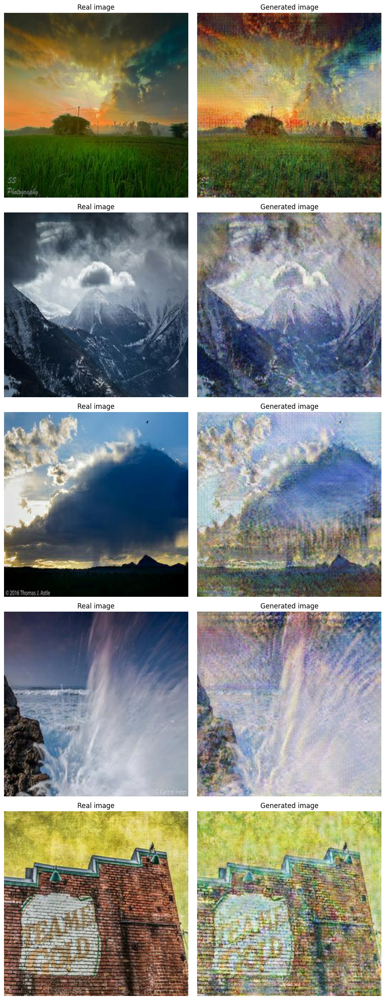

In [26]:
val_subset = torch.utils.data.Subset(
    val_loader.dataset, torch.randint(0, len(val_loader.dataset), (5,))
)
generate_monet_images(model.generator_Y, val_subset, device="cuda", num_images=5)

While it is clearly not the best results we could get, we can see, that model is able to generate some paintings and it`s impressive.

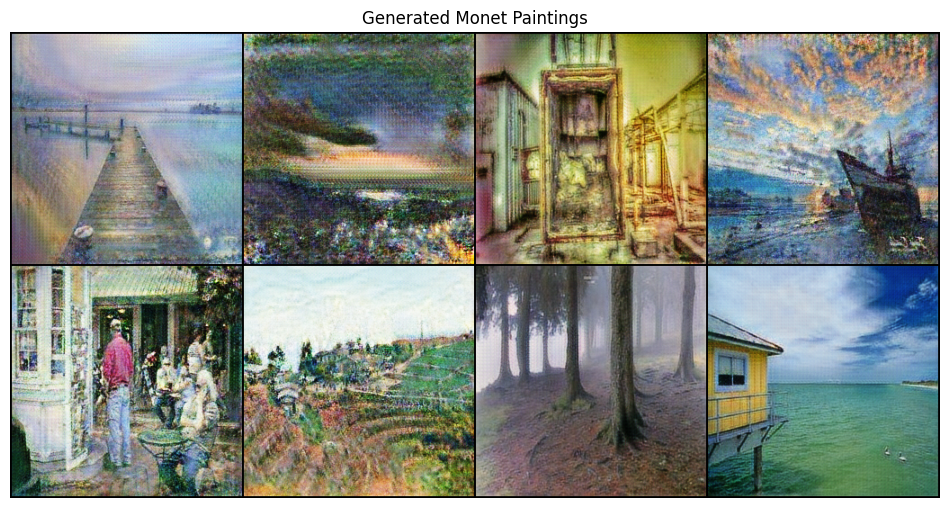

In [27]:
def show_generated_images(generator, photo_loader, device, num_images=16):
    generator.eval()

    with torch.no_grad():
        real_photos, monet_images = next(iter(photo_loader))
        real_photos = real_photos[:num_images].to(device)
        fake_monets = generator(real_photos).cpu()

    grid = vutils.make_grid(fake_monets, nrow=4, normalize=True)

    plt.figure(figsize=(12, 12))
    plt.imshow(grid.permute(1, 2, 0))
    plt.axis("off")
    plt.title("Generated Monet Paintings")
    plt.show()


show_generated_images(model.generator_Y, train_loader, device=DEVICE)

# MiFID score

For kaggle competition authors use MiFID score to evaluate models. MiFID score is a metric that measures the quality of generated images. It is based on the Fréchet Inception Distance (FID) score, which is a metric that measures the similarity between generated images and real images. The MiFID score is the FID score calculated using a feature extractor trained on the ImageNet dataset. The lower the MiFID score, the better the quality of the generated images.

For this we will use torchmetrics library.

In [28]:
from torchmetrics.image.mifid import MemorizationInformedFrechetInceptionDistance


def compute_mifid(model, dataloader, device, num_images=np.inf):
    mifid = MemorizationInformedFrechetInceptionDistance().to(device)

    processed_images = 0
    with torch.no_grad():
        for real_batch, monet_batch in dataloader:
            if processed_images >= num_images:
                break

            real_batch = real_batch.to(device)
            monet_batch = monet_batch.to(device)
            
            fake_batch = model(real_batch)

            monet_batch_uint8 = (monet_batch * 255).byte()
            fake_batch_uint8 = (fake_batch * 255).byte()

            mifid.update(monet_batch_uint8, real=True)
            mifid.update(fake_batch_uint8, real=False)

            processed_images += real_batch.size(0)

    return mifid.compute()

In [29]:
compute_mifid(model.generator_Y, val_loader, device=DEVICE)

tensor(209.9352, device='cuda:0')

# Generate submission

In [33]:
def generate_monet_and_save_to_zip(model, dataloader, device, output_zip):
    model.eval()
    temp_dir = "/tmp/temp_monet_images"
    os.makedirs(temp_dir, exist_ok=True)

    with torch.no_grad():
        image_paths = []
        for idx, real_images in enumerate(dataloader):
            real_images = real_images.to(device)
            generated_images = model(real_images)

            if generated_images.dim() == 3:
                generated_images = generated_images.unsqueeze(0)

            generated_images = generated_images.cpu().permute(
                0, 2, 3, 1
            )  # Convert to (batch, H, W, C)

            for j in range(generated_images.shape[0]):
                image = generated_images[j]
                image = (image * 0.5 + 0.5).numpy()  # Convert to [0, 1] range
                image = (image * 255).astype(np.uint8)  # Convert to [0, 255]
                image = Image.fromarray(image)

                # Unique filename
                filename = f"image_{idx * generated_images.shape[0] + j}.jpg"
                filepath = os.path.join(temp_dir, filename)
                image.save(filepath)
                image_paths.append(filepath)

    # Save all images to a ZIP file
    with zipfile.ZipFile(output_zip, "w") as zipf:
        for file in image_paths:
            zipf.write(file, os.path.basename(file))

    shutil.rmtree(temp_dir)

    print(f"Saved {len(image_paths)} images to {output_zip}")

In [34]:
dataset = SingleDomainImageDataset(photos_path, transformations=val_transform)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, pin_memory=True)

In [39]:
generate_monet_and_save_to_zip(
    model.generator_Y,
    dataloader,
    device=DEVICE,
    output_zip="monet_images.zip",
)

Saved 7038 images to monet_images.zip
